In [1]:
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

In [2]:
def find_diagnose(filename):

    with open(filename, "r") as file:
        lines = file.readlines()

    for line in lines:
        tofind = "# Reason for admission: "
        start = len(tofind)
        if tofind in line:
            diagnose = line[start:].strip()
    if diagnose == "n/a":
        return None
    else: #some signals in the dataset don't have a diagnose
        return diagnose

In [3]:
def remove_baselineshift_window(window):
    #compute median
    modes = np.median(window, axis = 1)
    
    to_return = np.zeros_like(window)
    #signal - mode
    for ch, mode in enumerate(modes):
        w_ch = window[ch, :]
        if mode < 0:
            to_return[ch, :] = w_ch - mode
        else:
            to_return[ch, :] = w_ch + mode
        #return
    return to_return

In [4]:
import wfdb

In [5]:
def multichannel_resample(signal, new_lenght):
    nchs = 15
    resampled_signal = np.zeros((new_lenght, nchs))
    for ch in range(nchs):
        resampled_signal[:, ch] = resample(signal[:, ch], new_lenght)
        #print(resampled_signal[:, ch].shape, resample(signal[:, ch], new_fs).shape)
    return resampled_signal

In [6]:
from scipy.signal import butter, lfilter, iirnotch

def bandpass(lowcut, highcut, order=3, fs = 500):
    
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

def notch_filter(cutoff, q, fs=500):
    
    nyq = 0.5*fs
    freq = cutoff/nyq
    b, a = iirnotch(freq, q)
    return b, a

def myfilter(lowcut, highcut, powerline, data):
    
    nchs = 12
    filtered_data = np.zeros_like(data)
    for ch in range(nchs):
        ch_data = data[:, ch]
        b, a = bandpass(lowcut, highcut)   
        x = lfilter(b, a, ch_data)
        f, e = notch_filter(powerline, 30)
        z = lfilter(f, e, x) 
        filtered_data[:, ch] = (x)
    return filtered_data

In [11]:
import os 
import numpy as np 
from scipy.signal import resample
os.chdir("..")
cwd = os.getcwd()+"\ptb-diagnostic-ecg-database-1.0.0"
patients = [filename for filename in os.listdir(cwd) if "patient" in filename]
y_patients = {}
signals = {}
map_signals = {} #i: patient/record
all_signals = []
notfiltered_signals = []
n = len(patients)
j = 0
for i, patient in enumerate(patients):
    
    print(i+1, "/", n, end="\r")
    patient_dir = cwd + os.sep + patient + os.sep
    records = [filename for filename in os.listdir(patient_dir) if ".dat" in filename]
    y_patients[patient] = {}
    signals[patient] = {}
    for record in records:
        filename = record[:-4] + ".hea"
        hea_file = patient_dir + filename
        diagnose = find_diagnose(hea_file)
        if diagnose is None:
            continue
        y_patients[patient][record] = diagnose
        path_record = patient_dir + record
        signal, fields = wfdb.rdsamp(path_record[:-4])
        signal = multichannel_resample(signal, int(signal.shape[0]/2)) #from 1000hz to 500hz
        notfiltered_signals.append(signal)
        filtered_signal = myfilter(0.5, 100, 50, signal)
        signals[patient][record] = filtered_signal
        all_signals.append(filtered_signal)
        map_signals[j] = patient + "/" + record    
        j += 1
        
#all_signals = np.array(all_signals)
#notfiltered_signals = np.array(notfiltered_signals)

In [ ]:
y_all = [diagnose for patient, temp in y_patients.items() for record, diagnose in temp.items()]
uqs, cnts = np.unique(y_all, return_counts = True)
for i, uq in enumerate(uqs):
    cnt = cnts[i]
    print(uq, ":", cnt)

In [ ]:
pathologies = uqs
pathologies

In [ ]:
pathology = pathologies[0]
pathology

In [11]:
from EcgStuffs.src.windows.WindowingUtils import sliding_window
    
windows = []
y_all_win = []

for i, signal in enumerate(all_signals):
    print("Signal", i+1, "/", len(all_signals), end="\r")
    signal = signal.T
    label = y_all[i]
    windows_signal = sliding_window(signal[:, 3000:], 2000, 1500) 
    #print()
    for j, window in enumerate(windows_signal):
        #if j+1 in np.arange(1, len(windows_signal), 1000):
            #print("Window", j+1, "/", len(windows_signal), end="\r")
        windows.append(window)
        y_all_win.append(label)

windows  = np.array(windows)
y_all_win = np.array(y_all_win)

In [12]:
bbb_index = np.argwhere(y_all_win == pathology).flatten()
bbb_index.shape

(607,)

In [13]:
bbb_windows = windows[bbb_index]
y_bbb = y_all_win[bbb_index]
bbb_windows.shape, y_bbb.shape

((607, 15, 2000), (607,))

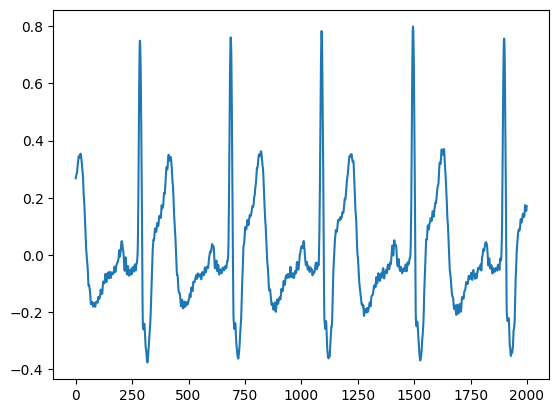

In [15]:
import matplotlib.pyplot as plt 
window = bbb_windows[0]
plt.plot(window[0, :])

In [16]:
def segment_multichannel(window, nchs = 12):
    
    beats_ch = {}
    for ch in range(nchs):
        window_segment = nk.ecg_segment(window[ch], sampling_rate = sampling_rate)
        if ch not in beats_ch.keys():
            beats_ch[ch] = []
        for key, value in window_segment.items():
            beats_ch[ch].append(value["Signal"])

    beats = [] 
    n_beats = len(beats_ch[ch])
    for i in range(n_beats):
        beat = []
        for ch in range(nchs):
            temp = beats_ch[ch][i].values
            beat.append(temp)
        #beat = np.array(beat)
        beats.append(beat)
    return beats

In [17]:
import neurokit2 as nk

nchs = 12
sampling_rate = 500
beats = segment_multichannel(window, nchs = nchs)
print(len(beats), len(beats[0]))

5 12


In [18]:
channels = ["I", "II", "III", "aVR", "aVL", "aVF", "V1", "V2" ,"V3", "V4", "V5", "V6", "X", "Y", "Z"]

In [24]:
import os 
cwd = os.getcwd()
sep = os.sep
fig_path = cwd + sep + "explainability" + sep + "Figures"
fig_path

'C:\\Users\\ugo-c\\Desktop\\ECG_DSS_CAE\\explainability\\Figures'

In [193]:
window = windows[0]
window = {channels[ch]: window[ch] for ch in range(nchs)}
explain_window(model, window)

TypeError: expected np.ndarray (got dict)

In [146]:
def plot_ecg(beat, pathologhy):
    
    # Define lead names and layout
    leads = ['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6']
    
    # Set up the figure and axes
    fig, axes = plt.subplots(4, 3, figsize=(20, 10))
    fig.subplots_adjust(hspace=0.5, wspace=0.3)

    sampling_rate = 500
    
    # Plot each lead in its respective subplot
    for i, lead in enumerate(leads):

        end_time = len(beat[lead]) / sampling_rate
        time = np.linspace(0, end_time, len(beat[lead]))
        row, col = divmod(i, 3)
        axes[row, col].plot(time, beat[lead], color='blue', linewidth=1)
        axes[row, col].set_title(lead, fontsize=10)
        axes[row, col].set_xlabel('Time (s)', fontsize=8)
        axes[row, col].set_ylabel('Amplitude (mV)', fontsize=8)
        axes[row, col].grid(True)
        x = [0, end_time]
        y = [min(beat[lead]), max(beat[lead])]
        plot_ecg_grid(axes[row, col], x ,y)

    
    # Remove unused subplots (if any)
    for i in range(len(leads), 12):
        row, col = divmod(i, 3)
        fig.delaxes(axes[row, col])
    
    # Add an overall title
    plt.suptitle('12-Lead ECG: ' + pathologhy, fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout to include the title
    plt.show()
    return fig

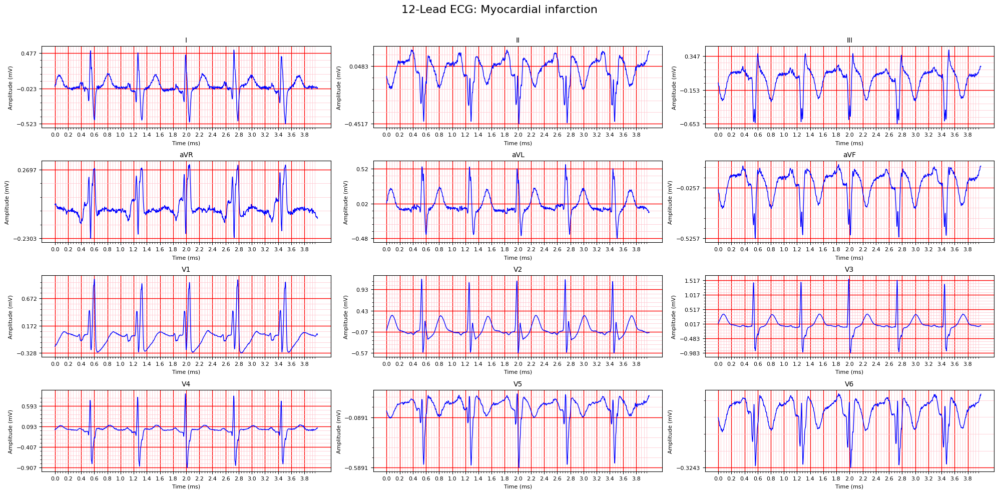

In [145]:
window = windows[0]
window = {channels[ch]: window[ch] for ch in range(nchs)}
fig = plot_ecg(window, pathology)
fig.savefig(fig_path + sep + "1.png", dpi = 200)

In [78]:
anomalous_index = np.argwhere(y_all_win != "Healthy control").flatten()
anomalous_windows = windows[anomalous_index]
anomalous_y = y_all_win[anomalous_index]
anomalous_y.shape, anomalous_windows.shape, anomalous_index.shape

((15377,), (15377, 15, 2000), (15377,))

In [141]:
# Function to create ECG grid
def plot_ecg_grid(ax, x, y):
    # Small grid (1 mm): typically corresponds to 0.04 seconds horizontally (25 mm/s)
    # and 0.1 mV vertically. Adjust scaling as needed.

    x_min, x_max = x
    y_min, y_max = y
    ax.set_xticks(np.arange(x_min, x_max, 0.04), minor=True)  # Small horizontal boxes (0.04 s)
    ax.set_yticks(np.arange(y_min, y_max, 0.1), minor=True)    # Small vertical boxes (0.1 mV)
    
    # Large grid (5 mm): corresponds to 0.2 seconds horizontally and 0.5 mV vertically
    ax.set_xticks(np.arange(x_min, x_max, 0.2))  # Large horizontal boxes (0.2 s)
    ax.set_yticks(np.arange(y_min, y_max, 0.5))   # Large vertical boxes (0.5 mV)

    # Draw grid lines
    ax.grid(which='minor', color='pink', linestyle='-', linewidth=0.5)  # Small grid lines
    ax.grid(which='major', color='red', linestyle='-', linewidth=1.0)  # Large grid lines
    
    ## Set limits for the plot
    #ax.set_xlim(x_min, x_max)
    #ax.set_ylim(y_min, y_max)


In [164]:
from collections import Counter

def stratified_sampling(X, y, n_samples):
    # Conta la distribuzione originale delle classi
    class_counts = Counter(y)
    class_ratios = {cls: count / len(y) for cls, count in class_counts.items()}
    #print(class_ratios)
    
    # Calcola il numero di campioni per ciascuna classe
    class_samples = {cls: int(round(ratio * n_samples)) for cls, ratio in class_ratios.items()}
    
    # Ottieni indici per ogni classe
    sampled_indices = []
    for cls, n_cls_samples in class_samples.items():
        indices = np.where(y == cls)[0]
        sampled_indices.extend(np.random.choice(indices, size=n_cls_samples, replace=True))  # Sostituzione per garantire dimensione
        
    # Mescola gli indici per evitare ordinamento
    np.random.shuffle(sampled_indices)
    return X[sampled_indices], y[sampled_indices]

In [185]:
k = 51
choosed_windows, choosed_y = stratified_sampling(anomalous_windows, anomalous_y, k)

In [186]:
np.unique(anomalous_y), np.unique(choosed_y)

(array(['Bundle branch block', 'Cardiomyopathy', 'Dysrhythmia',
        'Heart failure (NYHA 2)', 'Heart failure (NYHA 3)',
        'Heart failure (NYHA 4)', 'Hypertrophy', 'Myocardial infarction',
        'Myocarditis', 'Palpitation', 'Stable angina', 'Unstable angina',
        'Valvular heart disease'], dtype='<U22'),
 array(['Bundle branch block', 'Cardiomyopathy', 'Dysrhythmia',
        'Hypertrophy', 'Myocardial infarction', 'Myocarditis'],
       dtype='<U22'))

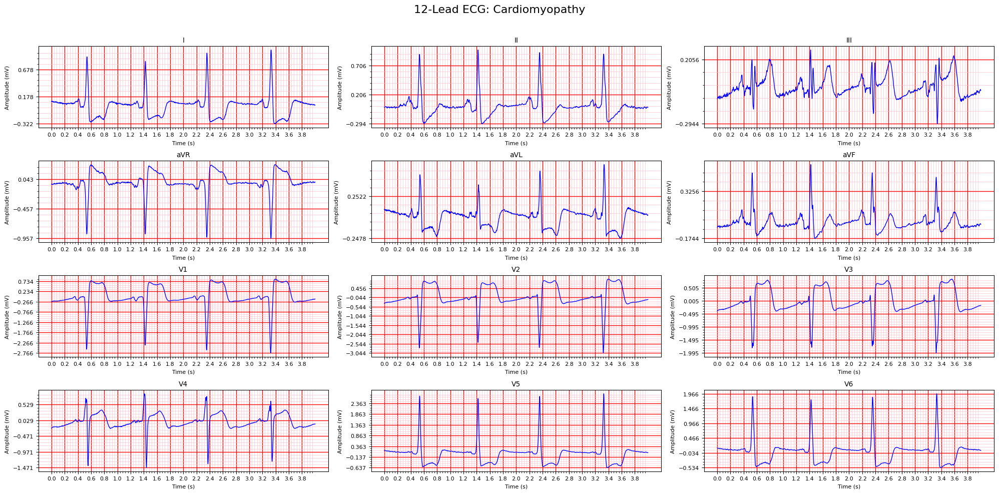

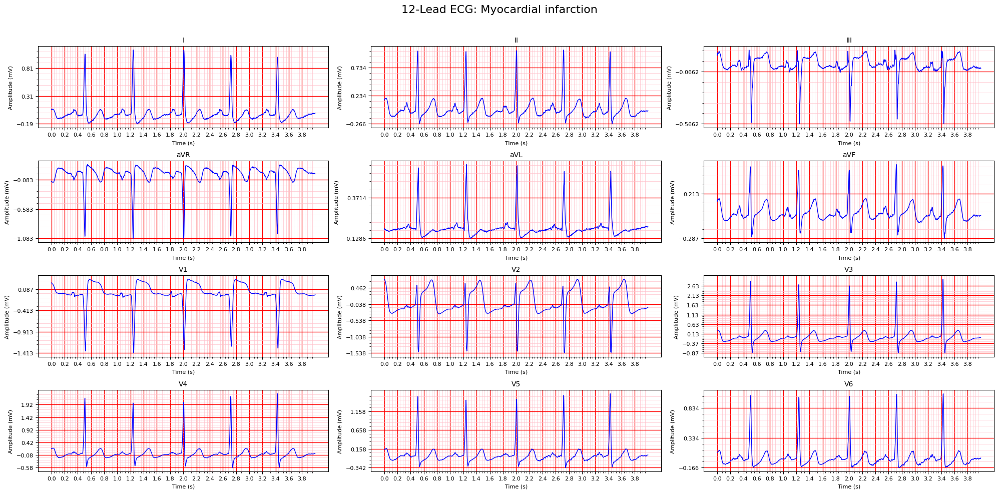

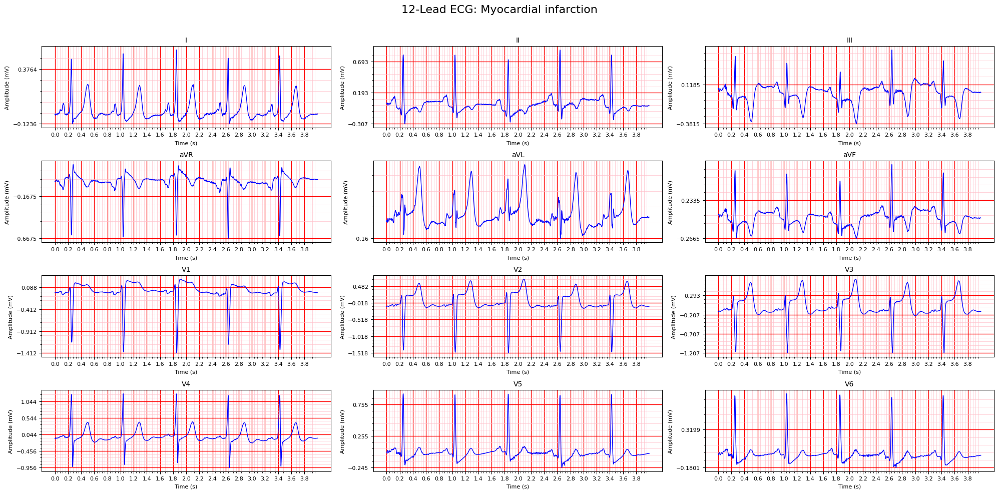

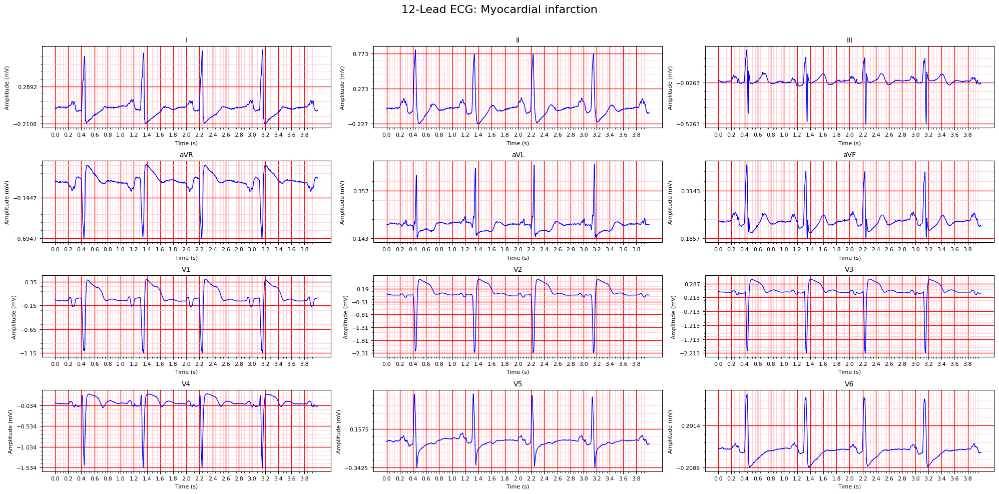

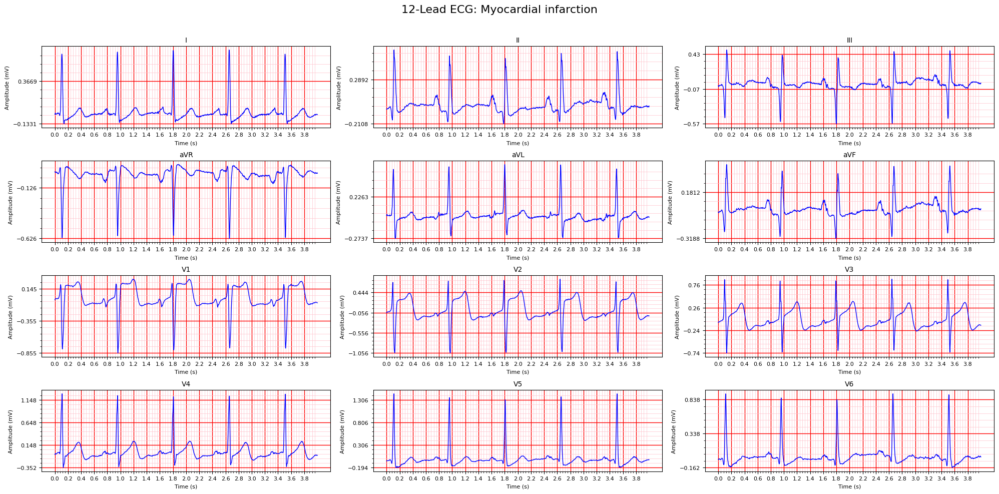

...

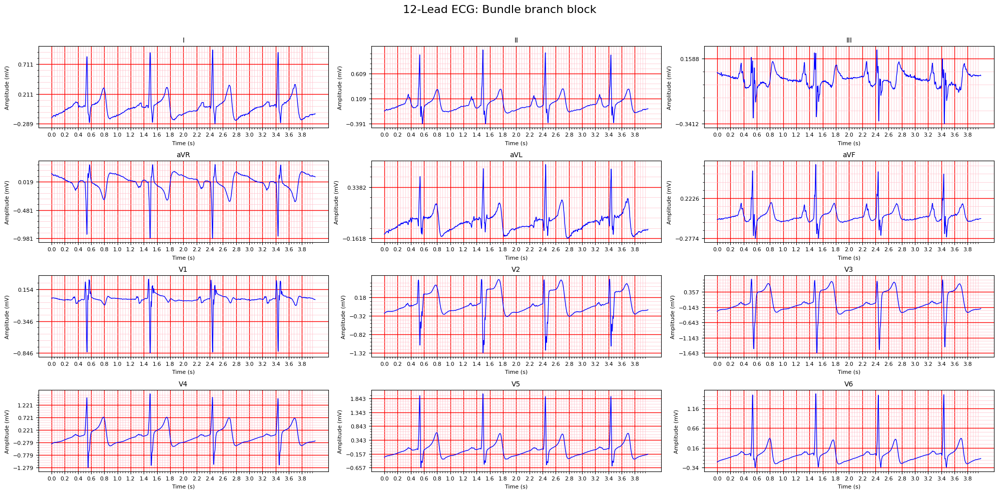

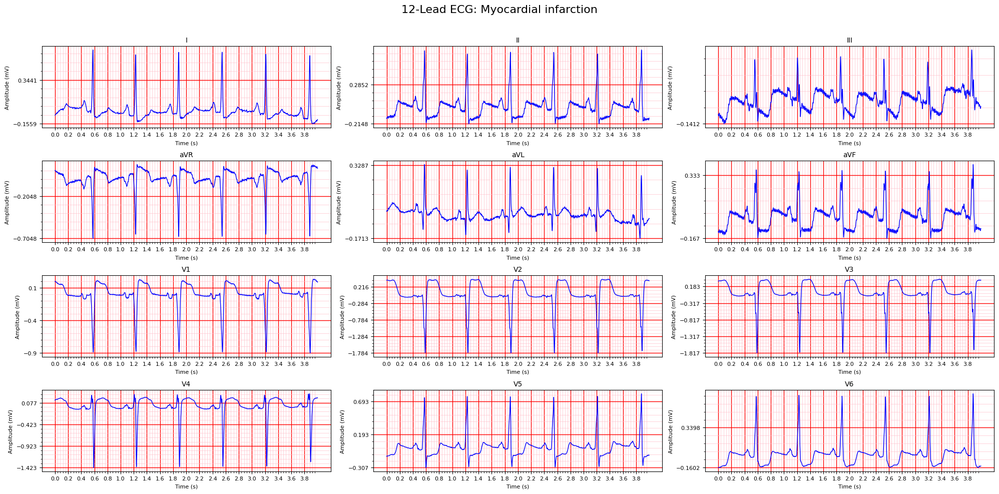

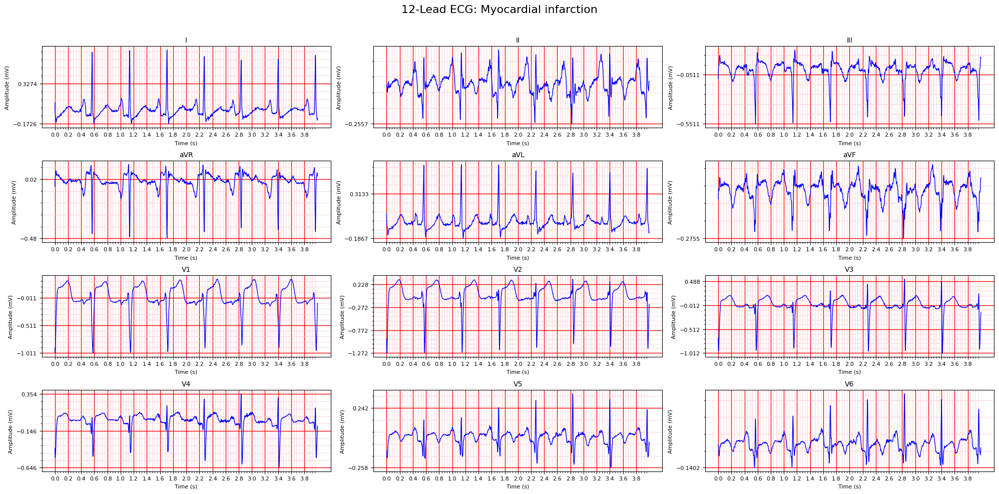

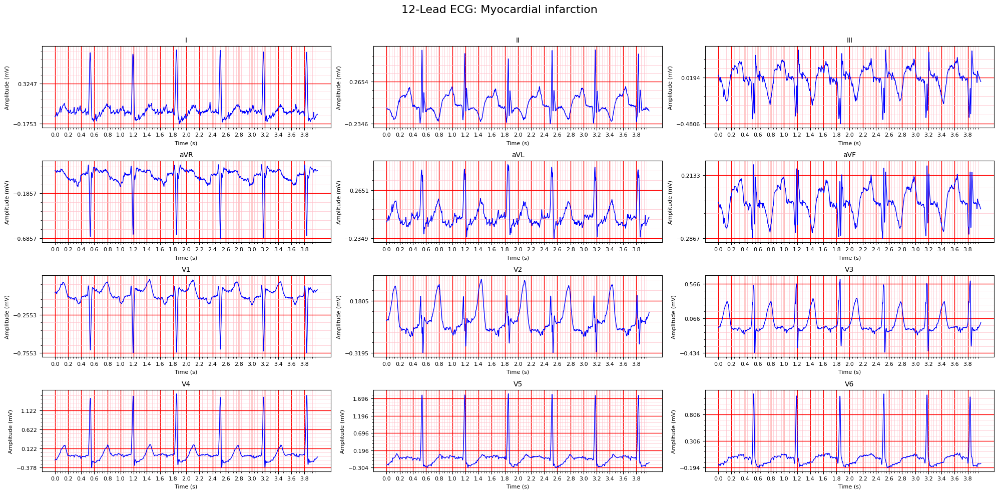

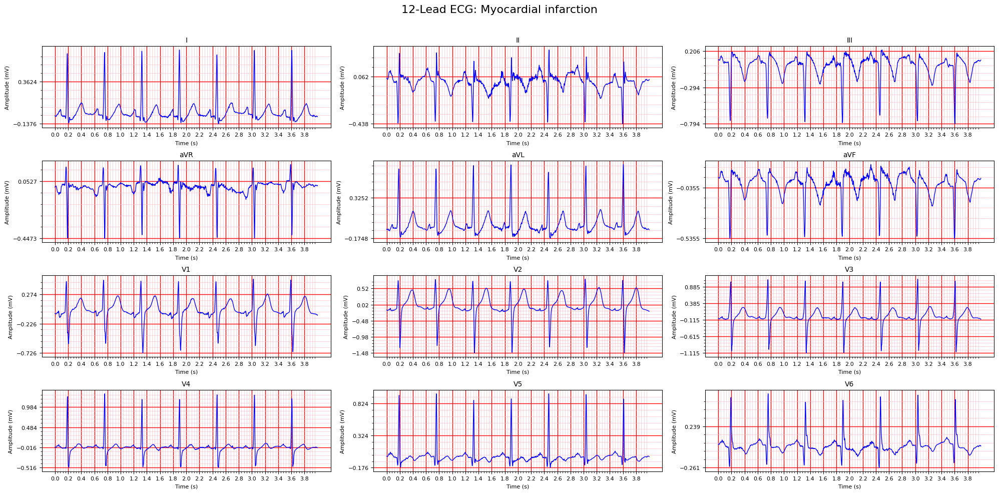

In [187]:
for i, (window, pathology) in enumerate(zip(choosed_windows, choosed_y)):
    window = {channels[ch]: window[ch] for ch in range(nchs)}
    fig = plot_ecg(window, pathology)
    fig.savefig(fig_path + sep + "{}.png".format(i+1), dpi = 200)

In [191]:
choosed_windows.shape

(51, 15, 2000)

In [190]:
torch.save(choosed_windows, "choosed_windows.pt")
torch.save(choosed_y,"choosed_y.pt")

In [12]:
import torch 
import os 

os.chdir("..")
cwd = os.getcwd()
sep = os.sep
cwd

'C:\\Users\\ugo-c\\Desktop\\ECG_DSS_CAE'

In [14]:
device = "cuda:0" if torch.cuda.is_available() else "cpu"
choosed_windows = torch.load(cwd+sep+"choosed_windows.pt")
choosed_y = torch.load(cwd+sep+"choosed_y.pt")
choosed_windows.shape

(51, 15, 2000)

In [15]:
choosed_y

array(['Cardiomyopathy', 'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocarditis', 'Myocardial infarction',
       'Hypertrophy', 'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction', 'Cardiomyopathy',
       'Myocardial infarction', 'Dysrhythmia', 'Myocardial infarction',
       'Myocardial infarction', 'Myocardial infarction',
       

In [16]:
from EcgStuffs.src.dpnet import dpnet_loader, conf
if torch.cuda.is_available():
    model = dpnet_loader.load() #load auto encoder model
else:
    model =  dpnet_loader.load_cpu()
model.load_state_dict(torch.load("model.pt"))
model = model.to(device)
model

C:\Users\ugo-c\Desktop\ECG_DSS_CAE


DPNet(
  (encoder): Encoder(
    (conv_0): Conv2d(1, 15, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (activation0): Tanh()
    (conv_1): Conv2d(15, 30, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
    (activation1): Tanh()
    (block_0): EncoderBlock(
      (conv2d_in): Conv2d(30, 30, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (activation_in): Tanh()
      (batch_norm_in): BatchNorm2d(30, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (dropout_in): Dropout(p=0.2, inplace=False)
      (conv2d_out): Conv2d(30, 45, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (skip_con): Sequential(
        (0): Conv2d(30, 45, kernel_size=(1, 1), stride=(2, 2), bias=False)
        (1): BatchNorm2d(45, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (batch_norm_out): BatchNorm2d(45, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (activation_o

In [248]:
import torch.nn.functional as F 
import neurokit2 as nk 
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt 
import numpy as np 
import matplotlib.patches as patches

def explain_window(model, window, pathology, th = None, mult = 10, step = 50, limit_min = 250, limit_max = 1250):
   
    window = torch.from_numpy(window).float().to(device)
    window = torch.unsqueeze(window, dim = 0)
    window = torch.unsqueeze(window, dim = 0)

    model = model.to(device)
    
    rec = model(window)
    reconstruction_error = F.mse_loss(rec, window).item()
    # Define lead names and layout
    leads = ['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6']

    window = window[0, 0, :, :].cpu().detach().numpy()
    rec = rec[0, 0, :, :].cpu().detach().numpy()

    # Set up the figure and axes
    fig, axes = plt.subplots(4, 3, figsize=(12, 8))
    fig.subplots_adjust(hspace=0.5, wspace=0.3)

    _, rpeaks = nk.ecg_peaks(window[0, :], sampling_rate=500)
    rpeaks = rpeaks["ECG_R_Peaks"] 
    rpeaks = [rpeak - limit_min for rpeak in rpeaks if rpeak <= limit_max and rpeak >= limit_min]

    window = window[:, limit_min:limit_max]
    rec = rec[:, limit_min:limit_max]

    # Plot each lead in its respective subplot
    res = {}
    for i, lead in enumerate(leads):
        if lead not in res.keys():
            res[lead] = []

        #max_ = max([max(window[i, :]), max(rec[i, :])]).item()
        #min_ = min([min(window[i, :]), min(rec[i, :])]).item()
        
        max_ = max(window[i, :]).item()
        min_ = min(window[i, :]).item()
        
        row, col = divmod(i, 3)
        axes[row, col].plot(window[i, :], color='blue', linewidth=1)
        #axes[row, col].plot(rec[i, limit_min:limit_max], '--', color = 'orange', linewidth=1)
        rpeaks_values = [window[i, rpeak] for rpeak in rpeaks]
        axes[row, col].plot(rpeaks, rpeaks_values, '*', color = 'green')
        
        axes[row, col].set_title(lead, fontsize=10)
        axes[row, col].set_xlabel('Time (s)', fontsize=8)
        axes[row, col].set_ylabel('Amplitude (mV)', fontsize=8)
        axes[row, col].grid(True)
        
        diff = abs(window-rec)

        for start in range(0, int(limit_max - limit_min), step):
            
            end = start + step       
            compute_re = True
            
            for rpeak in rpeaks:    
                
                if rpeak in np.arange(start, end):
                    re = 0.0 
                    # Create a Rectangle patch
                    #rect = patches.Rectangle((start, min_), step, abs(min_)+abs(max_), linewidth=1, edgecolor='r', facecolor='none')
                    #axes[row, col].add_patch(rect)
                    compute_re = False
                    break
                
                next_interval = np.arange(end, end+step)
                prev_interval = np.arange(start-step, end)
                
                if rpeak in next_interval:
                    re = 0.0
                    #rect = patches.Rectangle((start, min_), step, abs(min_)+abs(max_), linewidth=1, edgecolor='r', facecolor='none')
                    #axes[row, col].add_patch(rect)
                    compute_re = False
                    break
                if rpeak in prev_interval:
                    re = 0.0
                    #rect = patches.Rectangle((start, min_), step, abs(min_)+abs(max_), linewidth=1, edgecolor='r', facecolor='none')
                    #axes[row, col].add_patch(rect)
                    compute_re = False
                    break
                    
            if compute_re:
                re = F.mse_loss(torch.tensor(rec[i, start:end]), torch.tensor(window[i, start:end])).item()
            res[lead].append(re)
            #start = end 

    if th is not None:
        
        to_norm = []
        for lead, re in res.items():
            to_norm.append(re)
        to_norm = np.array(to_norm)
        if np.max(to_norm) > th:
            res_norm = MinMaxScaler(clip=True).fit_transform(to_norm)
        else:
            res_norm = to_norm
        
        temp = {}
        for i, lead in enumerate(leads):
            temp[lead] = res_norm[i]
        res_norms = temp
    
    else:
        res_norms = {}
        for lead, re in res.items():
            re = list(re)
            res_norms[lead] = [elem*mult for elem in re]
        
        
    for ch, (lead, res_norm) in enumerate(res_norms.items()):

        #max_ = max([max(window[ch, :]), max(rec[ch, :])]).item()
        #min_ = min([min(window[ch, :]), min(rec[ch, :])]).item()
        max_ = max(window[ch, :]).item()
        min_ = min(window[ch, :]).item()
        
        row, col = divmod(ch, 3)
        
        for i, alpha in enumerate(res_norm):
        
            start = i*step
            end = start + step
            toplot = np.arange(start, end)
            if alpha >= 1:
                alpha = 1
            axes[row, col].fill_between(toplot, max_, min_, color = "r", alpha = alpha)

            
    # Remove unused subplots (if any)
    for i in range(len(leads), 12):
        row, col = divmod(i, 3)
        fig.delaxes(axes[row, col])

    # Add an overall title
    plt.suptitle('12-Lead ECG, PTB Pathology: ' + pathology , fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout to include the title
    return fig 


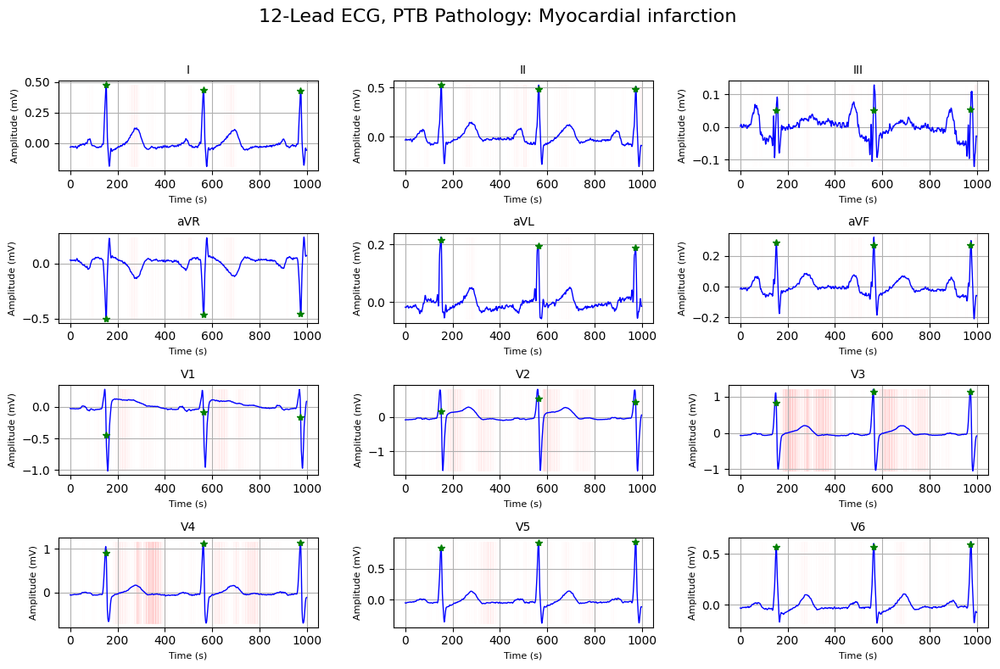

In [252]:
index = 19
window, pathology = choosed_windows[index], choosed_y[index]
fig = explain_window(model, window, pathology, mult = 4.0, step = 10)

In [246]:
figexp_path = cwd + sep + "explainability" + sep + "Figures_exp" + sep
figexp_path

'C:\\Users\\ugo-c\\Desktop\\ECG_DSS_CAE\\explainability\\Figures_exp\\'

C:\Users\ugo-c\AppData\Local\Temp\ipykernel_20908\2170793785.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(4, 3, figsize=(12, 8))


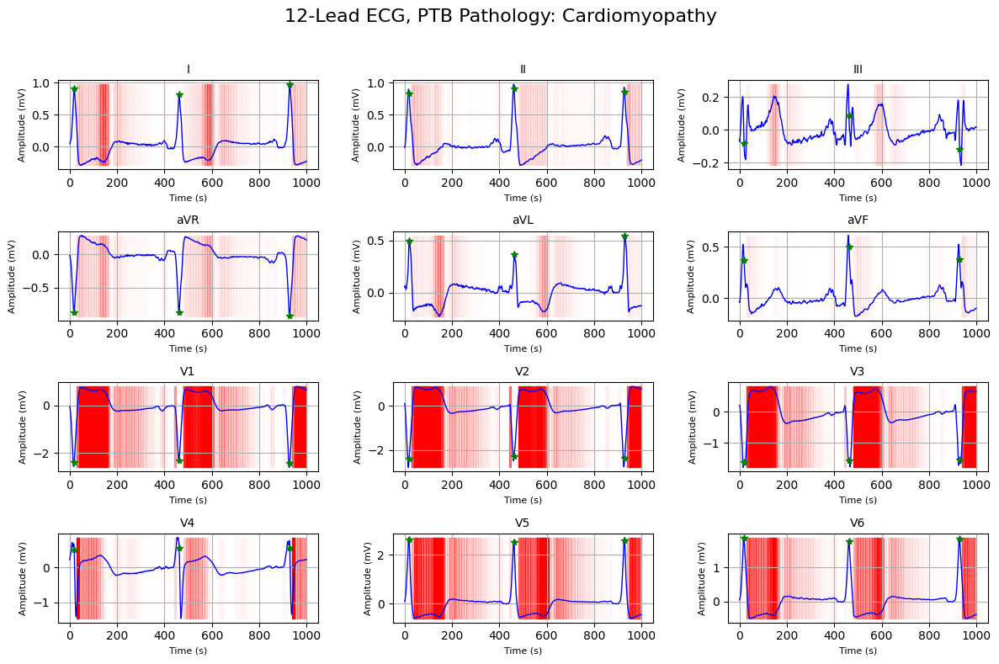

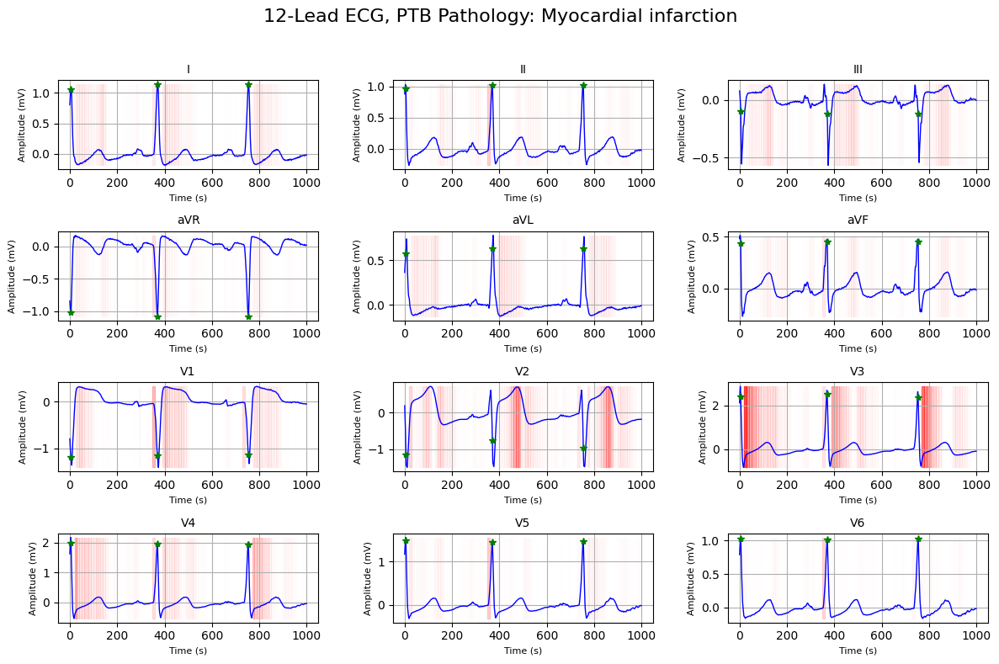

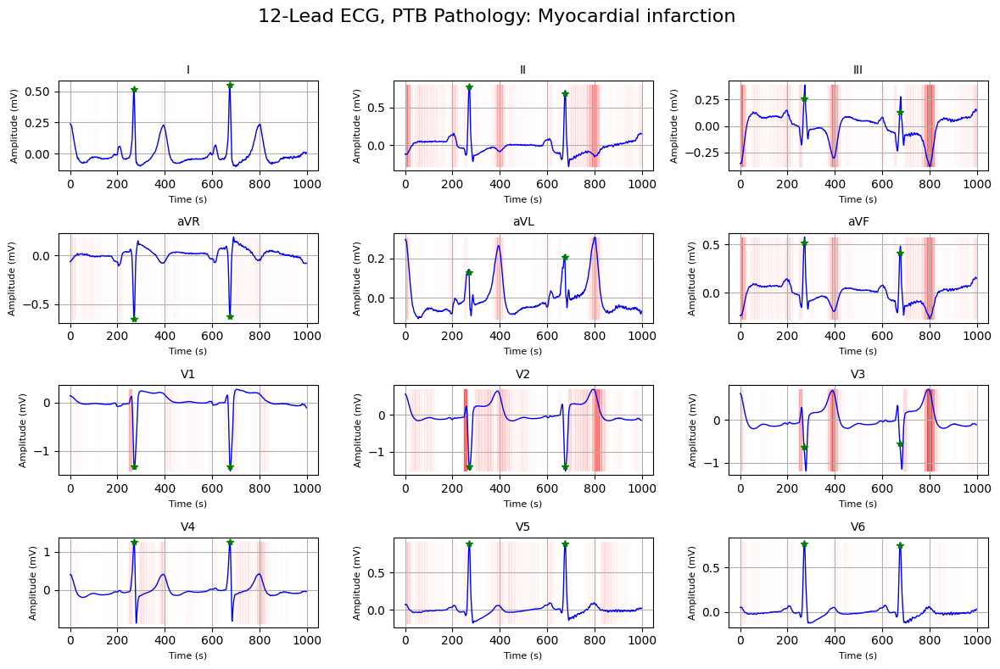

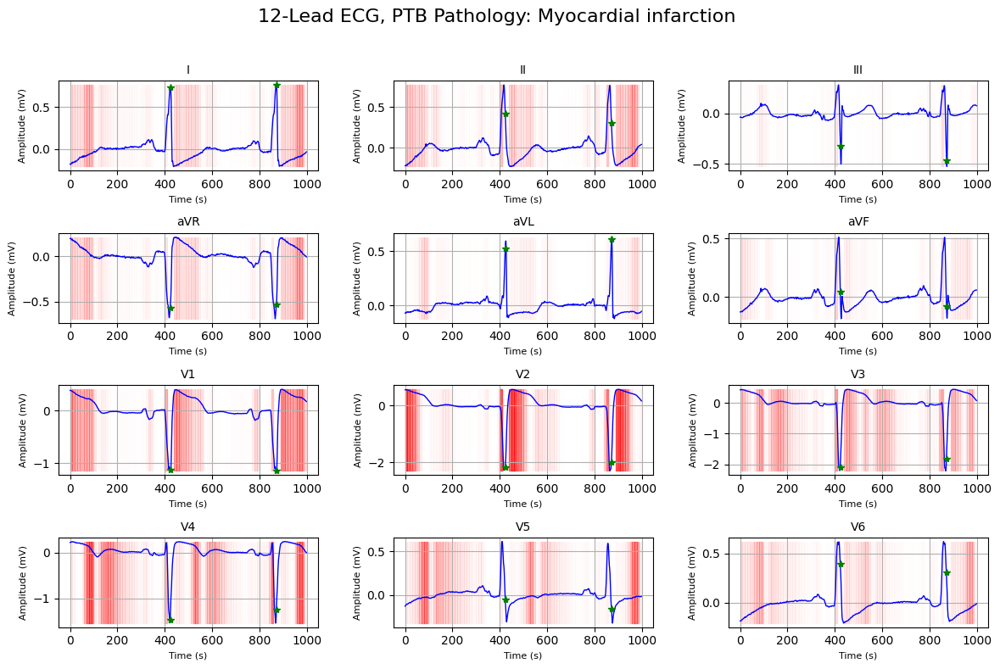

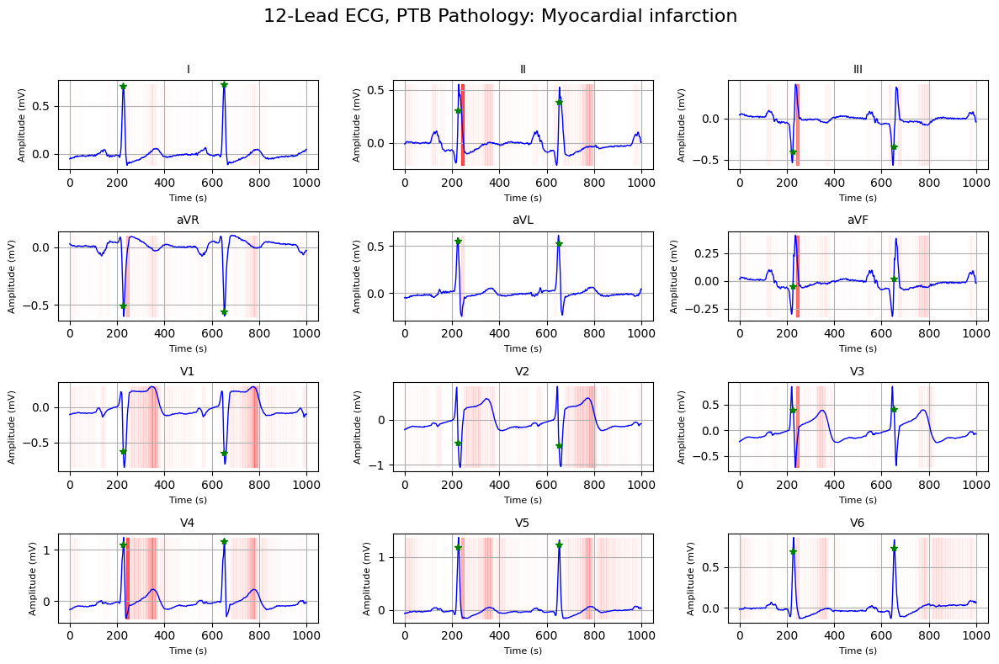

...

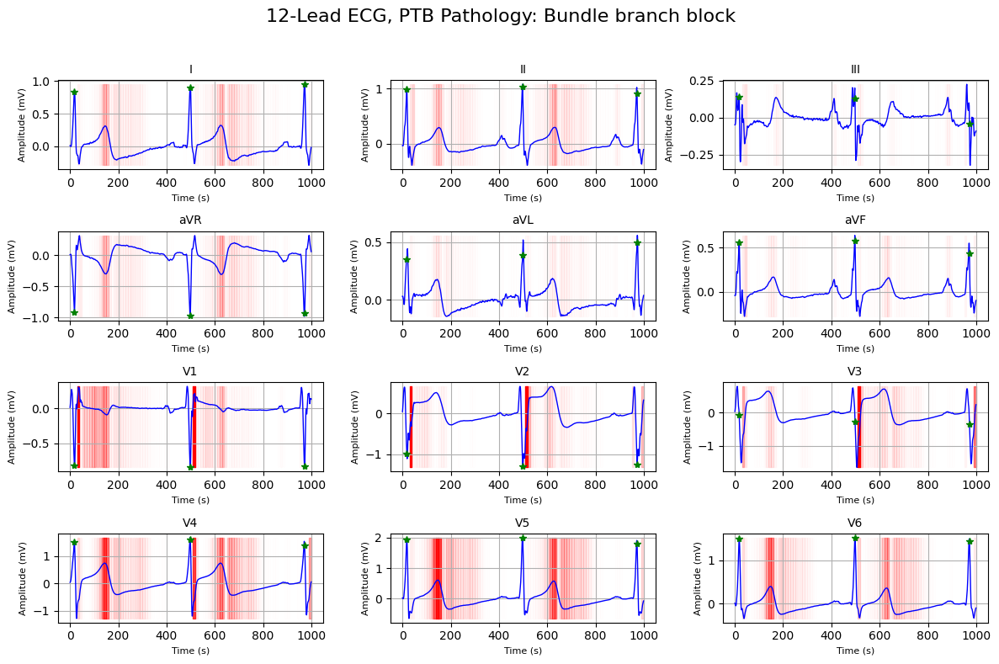

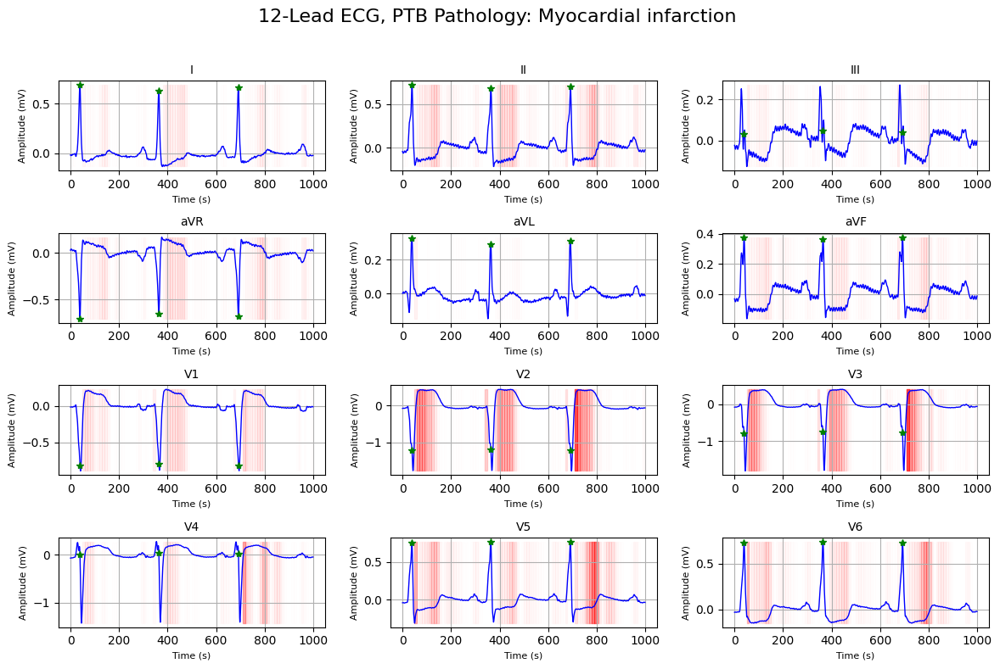

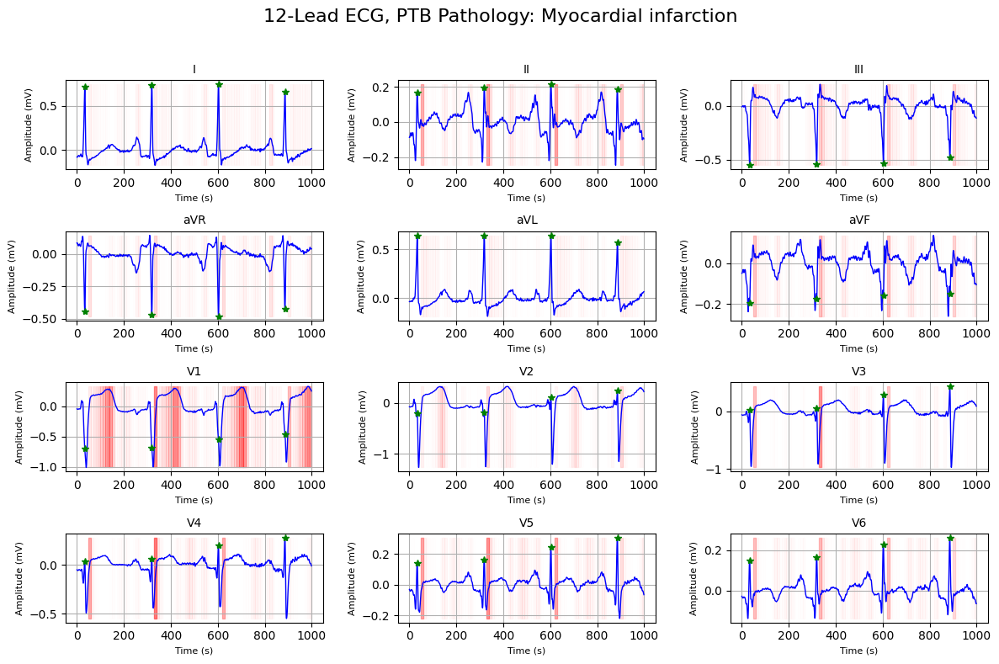

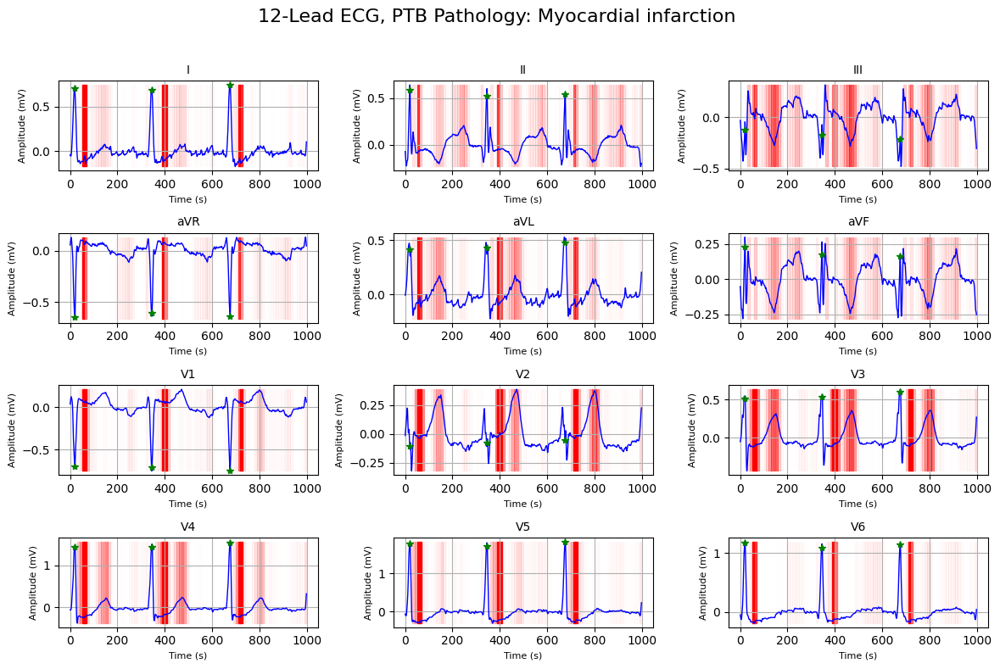

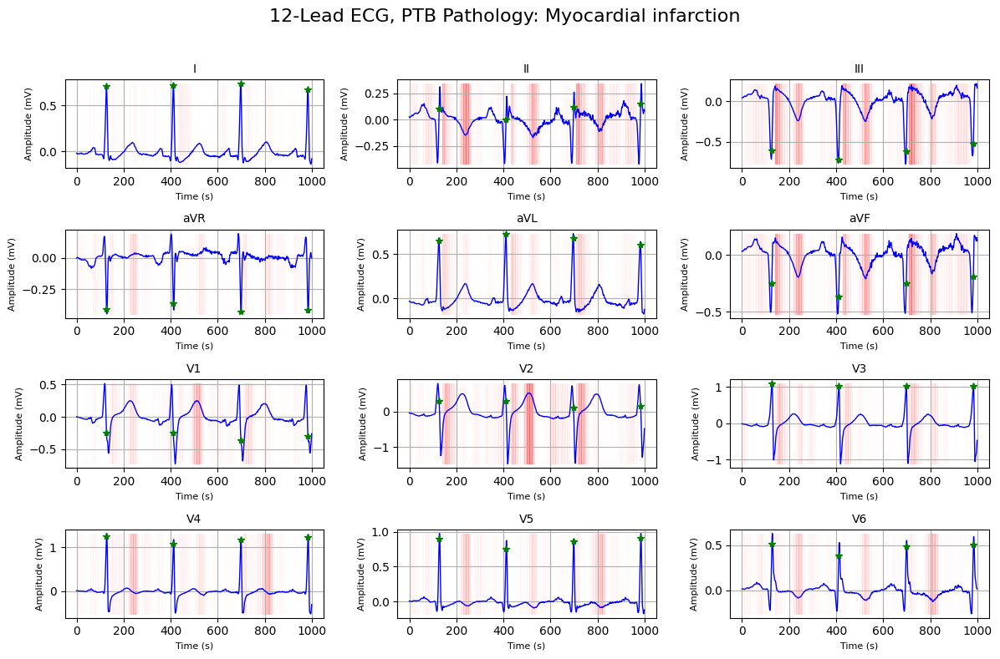

In [253]:
for i, (window, pathology) in enumerate(zip(choosed_windows, choosed_y)):
    print(i+1, "/", len(choosed_y), end = "\r")
    fig = explain_window(model, window, pathology, mult = 4.0, step = 10)
    fig.savefig(figexp_path + sep + "{}.png".format(i+1), dpi = 200)